<a href="https://colab.research.google.com/github/Yanni-Dhevictor/Desafio-Americanas/blob/main/Desafio_Americanas.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

###Objetivos do desafio

* Análise exploratória dos dados
* Preparação dos dados
* Modelagem
* Avaliação da performance do modelo
* Entrega do modelo

ENTREGA
1) 

1.   Crie um repositório em https://github.com/ e compartilhe conosco.
2.   Documente as atividades mencionadas na seção anterior, através do
README do repositório criado no item anterior.
3.   Informe, também no README do repositório, como podemos
executar/"rodar" a solução que você construiu.


###Importação de pacotes e dados

In [ ]:
#Adicionando a biblioteca para o treino do modelo
from warnings import simplefilter
simplefilter(action='ignore', category=FutureWarning)

!pip install -q scikit-plot

In [ ]:
#Importando os pacotes necessários
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import scikitplot as skplt


In [ ]:
#Importando os pacotes para o modelo

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score, roc_curve, accuracy_score
from imblearn.under_sampling import RandomUnderSampler
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

In [ ]:
#Instalando a ferramenta de processamento de dados pyarrow para ler o arquivo parquet
!pip install pyarrow -q

In [ ]:
#Realizando a leitura do arquivo parquet.
parquet_file = r"/content/dataset_cdjr.parquet.gzip"

df = pd.read_parquet(parquet_file,engine="auto")

###Análise Exploratória dos dados

In [ ]:
#Vendo as 5 primeiras entradas
df.head()

,feature0,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,feature11,feature12,feature13,feature14,feature15,target
337,200.0,2,662.28,39.10,-188.55,0.246978,761,0.004548,3.523703,167326,33441.06,0.019804,26.850,0.009198,94.611429,7,0
266,150.0,2,0.00,149.55,-0.45,0.150000,3,0.037975,0.000000,79,78.93,0.000000,0.000,0.000000,0.000000,0,1
236,50.0,1,346.08,30.41,-102.10,2.430952,42,0.004239,3.389618,9907,18858.77,0.018351,25.525,0.095238,86.520000,4,0
274,100.0,2,0.00,43.84,-56.16,0.150968,372,0.005854,0.000000,63544,1164.11,0.000000,0.000,0.000000,0.000000,0,1
208,50.0,1,87.56,-3.05,-94.50,0.412664,229,0.004572,0.926561,50089,1786.26,0.049019,94.500,0.004367,87.560000,1,0


In [ ]:
#Verificando as dimensões do dataset

print("Dimensões do Dataset",
    "\nVariáveis: ",df.shape[0],"\n" 
      "Entradas: ",df.shape[1])

Dimensões do Dataset 
Variáveis:  466 
Entradas:  17


In [ ]:
#Vendo as 5 últimas entradas
df.tail()

,feature0,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,feature11,feature12,feature13,feature14,feature15,target
490,1300.0,7,12133.73,244.30,-1081.90,0.395307,2642,0.008152,11.617895,324081,17343.28,0.699621,12.893827,0.030659,149.799136,81,0
175,350.0,1,0.00,-1.99,-351.99,0.684805,514,0.004000,0.000000,128499,2263.65,0.000000,0.000000,0.000000,0.000000,0,1
417,400.0,4,1100.07,-18.20,-438.60,0.748464,586,0.003683,2.508140,159109,5303.10,0.207439,62.657143,0.011945,157.152857,7,0
131,150.0,1,0.00,114.30,-35.70,0.300000,119,0.003834,0.000000,31040,334.59,0.000000,0.000000,0.000000,0.000000,0,0
92,50.0,1,0.00,-1.00,-51.00,1.961538,26,0.002537,0.000000,10250,0.00,0.000000,0.000000,0.000000,0.000000,0,1


In [ ]:
df.describe()

,feature0,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,feature11,feature12,feature13,feature14,feature15,target
count,466.000000,466.000000,466.000000,466.000000,466.000000,466.000000,466.000000,466.000000,466.000000,4.660000e+02,466.000000,466.000000,466.000000,466.000000,466.000000,466.000000,466.000000
mean,438.743562,4.847639,1244.322468,44.600880,-434.299893,0.473991,979.070815,0.113885,3.857010,2.164378e+05,6930.456438,0.437333,61.886190,0.008634,87.713360,10.313305,0.557940
std,984.593065,6.836679,3558.699033,122.093515,975.555198,0.452261,1460.738442,1.873746,15.609132,3.508622e+05,17581.800818,3.442094,142.521523,0.017866,145.426437,33.625204,0.497165
min,0.000000,0.000000,0.000000,-645.870000,-15506.350000,0.150000,1.000000,0.000663,0.000000,1.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,50.000000,1.000000,0.000000,-0.400000,-492.035000,0.173669,133.500000,0.003318,0.000000,2.113100e+04,383.687500,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,150.000000,2.000000,169.830000,18.360000,-154.525000,0.303854,420.000000,0.005127,0.937082,8.532850e+04,1410.855000,0.082515,19.692568,0.003207,72.524286,2.000000,1.000000
75%,500.000000,6.000000,1017.375000,44.630000,-50.180000,0.569848,1238.750000,0.009699,2.815824,2.645035e+05,5212.977500,0.311311,65.498098,0.009515,127.301505,8.000000,1.000000
max,15400.000000,31.000000,40291.240000,1521.900000,-0.260000,3.150000,11731.000000,40.000000,281.666667,3.366472e+06,237182.780000,73.080634,2232.100000,0.204611,2154.000000,541.000000,1.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 466 entries, 337 to 92
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   feature0   466 non-null    float64
 1   feature1   466 non-null    int64  
 2   feature2   466 non-null    float64
 3   feature3   466 non-null    float64
 4   feature4   466 non-null    float64
 5   feature5   466 non-null    float64
 6   feature6   466 non-null    int64  
 7   feature7   466 non-null    float64
 8   feature8   466 non-null    float64
 9   feature9   466 non-null    int64  
 10  feature10  466 non-null    float64
 11  feature11  466 non-null    float64
 12  feature12  466 non-null    float64
 13  feature13  466 non-null    float64
 14  feature14  466 non-null    float64
 15  feature15  466 non-null    int64  
 16  target     466 non-null    int64  
dtypes: float64(12), int64(5)
memory usage: 65.5 KB


In [ ]:
#Checando por valores duplicados
df.duplicated().sum()

0

In [ ]:
#Procurando por dados ausentes por variável
(df.isnull().sum()).sort_values(ascending=False)

feature0     0
feature9     0
feature15    0
feature14    0
feature13    0
feature12    0
feature11    0
feature10    0
feature8     0
feature1     0
feature7     0
feature6     0
feature5     0
feature4     0
feature3     0
feature2     0
target       0
dtype: int64

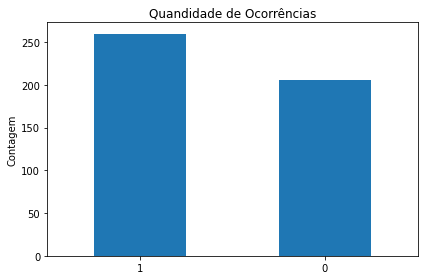

In [ ]:
#Plotando a quantidade de ocorrências e possível identificação de dados desbalanceados

df.target.value_counts().plot(kind="bar")
plt.title("Quandidade de Ocorrências")
plt.xticks(rotation=0)
plt.ylabel("Contagem")

plt.tight_layout()
plt.show()

In [ ]:
#Plotando o pandas profilling
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip -q

     - 21.9 MB 75 kB/s
     |████████████████████████████████| 596 kB 7.2 MB/s 
     |████████████████████████████████| 102 kB 33.9 MB/s 
     |████████████████████████████████| 690 kB 11.4 MB/s 
     |████████████████████████████████| 4.7 MB 11.7 MB/s 
     |████████████████████████████████| 62 kB 1.5 MB/s 
     |████████████████████████████████| 812 kB 42.1 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.28.1 which is incompatible.


In [ ]:
#Importando a biblioteca necessária
from pandas_profiling import ProfileReport

In [ ]:
#Criando o Profile Report
report = ProfileReport(df)

#Criando a vizualização do Iframe
report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#Separação das ocorrências 1 e 0
df_zero= df.loc[df.target == 0]
df_one= df.loc[df.target == 1]

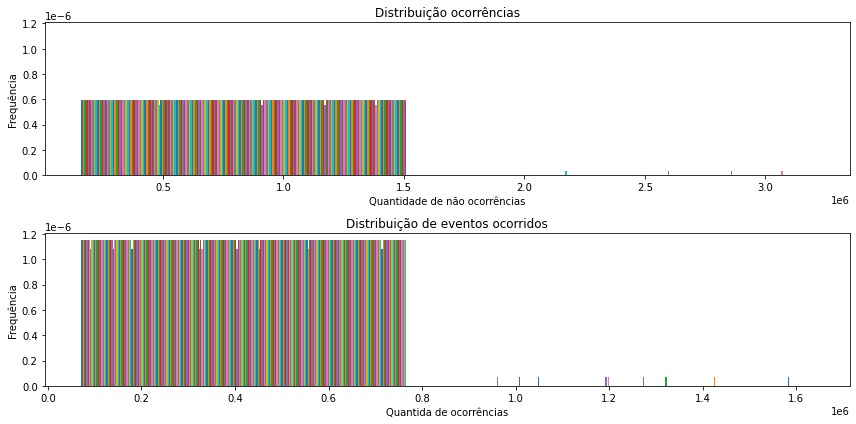

In [ ]:
#Plotando o histograma das ocorrências
fig, ax = plt.subplots(nrows = 2, ncols=1, sharey = True, tight_layout=True, figsize=(12,6))

ax[0].hist(df_zero,density = True,bins=2)
ax[0].set_title("Distribuição ocorrências")
ax[0].set_xlabel("Quantidade de não ocorrências")
ax[0].set_ylabel("Frequência")

ax[1].hist(df_one,density= True,bins = 2)
ax[1].set_title("Distribuição de eventos ocorridos")
ax[1].set_xlabel("Quantida de ocorrências")
ax[1].set_ylabel("Frequência")

plt.show();

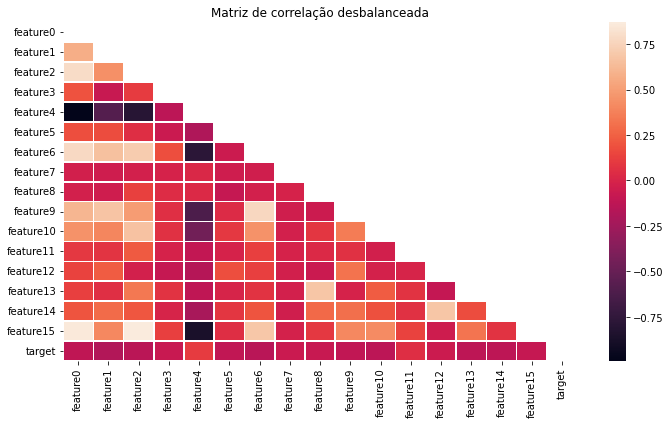

In [ ]:
#Plotando uma matriz de correlação antes do balanceamento
#correlação
plt.figure(figsize = (10, 6))
plt.title("Matriz de correlação desbalanceada")
correlation = df.corr()
mask = np.triu(correlation)

#plotagem da matriz de correlação
plot = sns.heatmap(correlation,fmt=".1f",linewidths=.6,mask=mask)
plt.tight_layout()
plt.show()

A medida de compreensão nessa plotagem é possível avaliar a correlação entre as diferentes variáveis do dataset, sendo as que estão mais escuras, as que possuem maior grau de relacionamento.

##Normalização dos dados

Nessa etapa é feita a normalização dos dados, a normalização serve para ajustas os valores existentes nas colunas numéricas do dataset, trazendo-os para uma escala comum não havendo distorção dos nos intervalos de valores.

###Separação dos dados de treino e teste

In [ ]:
#Criando 
df_features = df.drop("target",axis=1)

In [ ]:
# Criando o dataset somente com os dados das ocorrências
df_target = df["target"]
df_target

337    0
266    1
236    0
274    1
208    0
      ..
490    0
175    1
417    0
131    0
92     1
Name: target, Length: 466, dtype: int64


 Relatório de Classificação: 
               precision    recall  f1-score   support

           0     0.5426    0.4828    0.5109       145
           1     0.6212    0.6758    0.6474       182

    accuracy                         0.5902       327
   macro avg     0.5819    0.5793    0.5792       327
weighted avg     0.5864    0.5902    0.5869       327

Acurácia:0.5902

AUC: 0.5793



/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


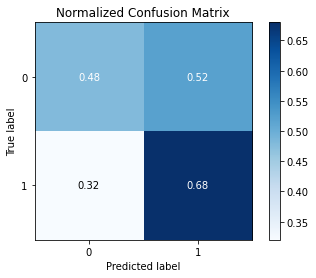

In [ ]:
#Separação dos dados de X e y para a modelagem de dados
X = df_features
y = df_target

#Dividindo os dados entre treino e teste
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.7,random_state=27)

#Escolhendo e instanciando o modelo de regressão Logística
model = LogisticRegression()
model.fit(X_train,y_train)

#Fazendo a previsão em cima dos dados de teste
y_pred = model.predict(X_test)
y_proba = model.predict(X_test)

#Plotando a matriz de confusão
skplt.metrics.plot_confusion_matrix(y_test,y_pred, normalize = True)

#Imprimir relatório de classificação
print("\n Relatório de Classificação: \n", classification_report(y_test, y_pred, digits=4))

#Imprimindo a acurácia do modelo
print("Acurácia:{:.4f}\n".format(accuracy_score(y_test,y_pred)))

#Imprimir a área sob a curva
print("AUC: {:.4f}\n".format(roc_auc_score(y_test,y_pred)))

fig.show();

Com base na Matriz de de confusão é possível notar que o modelo teve uma precisão para classificar não ocorrências de 54% e ocorrências positivas de 62%

0    61
1    61
Name: target, dtype: int64


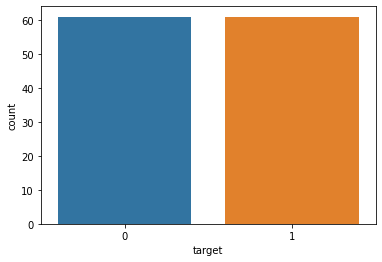

In [ ]:
#Balanceando o dataset
#Usando o under-sampling
rus = RandomUnderSampler()
X_res, y_res = rus.fit_resample(X_train,y_train)

#Ver o balanceamento de classes
print(pd.Series(y_res).value_counts())

#Plotando a nova distribuição de classes
sns.countplot(y_res);

In [ ]:
#Novo Dataframe balanceado
correlation_balanced = pd.DataFrame(X_res).corr()

In [ ]:
#Criando a máscara diagonal superior
mask = np.zeros_like(correlation_balanced)
mask[np.triu_indices_from(mask)] = True

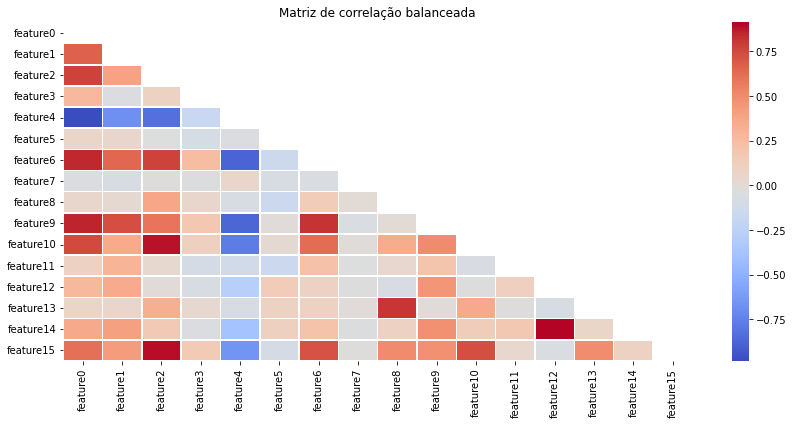

In [ ]:
#Plotando matriz de correlação Balanceada
plt.figure(figsize = (12, 6))
plt.title("Matriz de correlação balanceada")

sns.heatmap(correlation_balanced,mask = mask , fmt=".1f",linewidths=.6,cmap = 'coolwarm')
plt.tight_layout()
plt.show()


Com os dados balanceados, agora já é possível realizar o treino e averiguar a performance resultante

Relatório de Classificação:
               precision    recall  f1-score   support

           0     0.5134    0.6621    0.5783       145
           1     0.6500    0.5000    0.5652       182

    accuracy                         0.5719       327
   macro avg     0.5817    0.5810    0.5718       327
weighted avg     0.5894    0.5719    0.5710       327

Acurácia: 0.5719

AUC: 0.5810



/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


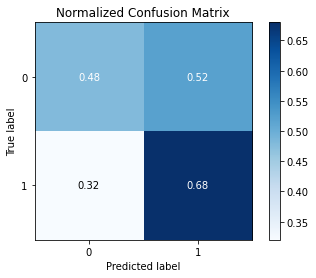

In [ ]:
#Instanciando e treinando o modelo de regressão logistica
model_res = LogisticRegression()
model_res.fit(X_res, y_res)

#Realizando a previsão em cima dos dados de teste
y_pred_res = model_res.predict(X_test)
y_proba_res = model_res.predict_proba(X_test)

#Plotando a matrix de confusão
skplt.metrics.plot_confusion_matrix(y_test,y_pred,normalize=True)

#Imprimindo o classification report
print("Relatório de Classificação:\n", classification_report(y_test,y_pred_res,digits=4))

#Imprimir a acurácia do modelo
print("Acurácia: {:.4f}\n".format(accuracy_score(y_test,y_pred_res)))

#Imprimir a área sob a curva
print("AUC: {:.4f}\n".format(roc_auc_score(y_test,y_pred_res)))

Com o dataset balanceado a precisção da classificação foi 51,4% para não cocorrências (0) e 65% para ocorrências positivas(1) .

###Padronização dos dados

In [ ]:
#Utilizando o StandardScaler para realizar a padronização das variáveis
from sklearn.preprocessing import StandardScaler, MinMaxScaler

In [ ]:
#Normalizando usando o Sklearn
#Fit do scaler nos dados de treino
norm = MinMaxScaler().fit(X_train)

#Transformando Dados de treino
X_train_norm = norm.transform(X_train)

#Tranformando os dados de teste
#X_test_norm = norm.transform(X_test)

In [ ]:
print(X_train_norm,"\nDados de Treino Normalizados")

[[0.02597403 0.25806452 0.01360767 ... 0.01664708 0.05090715 0.00924214]
 [0.00974026 0.06451613 0.004566   ... 0.06100478 0.02846951 0.00554529]
 [0.         0.         0.01033575 ... 0.02798354 0.04833333 0.00739372]
 ...
 [0.03571429 0.06451613 0.02340956 ... 0.05214724 0.05473538 0.01478743]
 [0.         0.         0.0013941  ... 0.0720339  0.02607707 0.00184843]
 [0.00324675 0.03225806 0.         ... 0.         0.         0.        ]] 
Dados de Treino Normalizados


#Known Nearest Neighbor

A partir de agora, com o uso desse método de classificação, será possível identificar precisamente em qual classificação cada ponto presente no dataset pertence.

In [ ]:
from sklearn import neighbors
#Importando a biblioteca necessária
from sklearn.neighbors import KNeighborsClassifier

kvizinhos = KNeighborsClassifier(n_neighbors= 2)
kvizinhos

KNeighborsClassifier(n_neighbors=2)

In [ ]:
#Executando o modelo na base de treinamento
kvizinhos.fit(X_train, y_train)
_pred = kvizinhos.predict(X_train)
_pred
score = kvizinhos.score(X_train, y_train)
score

0.7482014388489209

In [ ]:
#Executando o modelo na base de teste
kvizinhos.fit(X_train, y_train)
_pred = kvizinhos.predict(X_train)
_pred

score = kvizinhos.score(X_test, y_test)
score

0.46788990825688076

Text(0, 0.5, 'Score Rate')

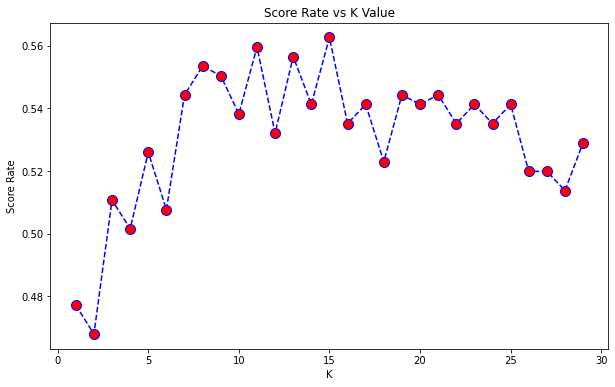

In [ ]:
#Avaliando qual é o melhor valor de K

#Importando o pacote necessário
from sklearn import metrics
score = []

for i in range(1,30):
  #instancia do Knn
  #treino do modelo 
  #inclusao do valor do score na lista

  classificador_ = KNeighborsClassifier(n_neighbors=i)
  classificador_.fit(X_train,y_train)
  y_pred = classificador_.predict(X_test)
  scorev = kvizinhos.score(X_train, y_train)
  score.append(metrics.accuracy_score(y_test, y_pred))

#Plotando os dados do valor de K  
plt.figure(figsize=(10,6))
plt.plot(range(1,30), score, color='blue', linestyle='dashed', marker='o',
          markerfacecolor = 'red', markersize=10)
plt.title('Score Rate vs K Value')
plt.xlabel('K')
plt.ylabel('Score Rate')

In [ ]:
#Criando um classificador com o melhor valor de K para avaliação

classificador_ = KNeighborsClassifier(n_neighbors=17)
classificador_.fit(X_train, y_train)
_pred = classificador_.predict(X_train)
_pred


#dados teste
score = classificador_.score(X_test, y_test)
print("Pontuação dos dados de Treino:",score) 

#dados treino
score_teste = classificador_.score(X_train, y_train)
print("Pontuação dos dados teste",score_teste) 


Pontuação dos dados de Treino: 0.5412844036697247
Pontuação dos dados teste 0.5971223021582733


Nessa etapa seguimos para a etapa de avaliação dos classificadores, proporcionando a liberação dos resultados.

In [ ]:
#Imprimindo o classification report
print("Dados da base de Treino: \n",classification_report(y_train, _pred))

Dados da base de Treino: 
               precision    recall  f1-score   support

           0       0.58      0.31      0.40        61
           1       0.60      0.82      0.70        78

    accuracy                           0.60       139
   macro avg       0.59      0.57      0.55       139
weighted avg       0.59      0.60      0.57       139



In [ ]:
#Imprimindo o classification report para o teste de X
_pred = classificador_.predict(X_test)
_pred

print("Dados da base de teste: \n",classification_report(y_test, _pred))

Dados da base de teste: 
               precision    recall  f1-score   support

           0       0.47      0.29      0.36       145
           1       0.57      0.74      0.64       182

    accuracy                           0.54       327
   macro avg       0.52      0.52      0.50       327
weighted avg       0.52      0.54      0.52       327



In [ ]:
#Mostrando o relatório para os dados de teste e predição
print(classification_report(y_test,y_pred))
plt.show()

              precision    recall  f1-score   support

           0       0.45      0.29      0.35       145
           1       0.56      0.72      0.63       182

    accuracy                           0.53       327
   macro avg       0.51      0.50      0.49       327
weighted avg       0.51      0.53      0.51       327



#Conclusão

Com base nos dados demonstrados é agora necessário identificar qual das manipulações feitas o os gráficos e os relatórios de classificação de cada variação do melhor valor de K.
